In [ ]:
import os

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from google.colab.patches import cv2_imshow
import cv2

In [ ]:
pip install stitching

In [ ]:
def convert_video_to_frames(video_path, output_folder):
    # Create output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Open the video file
    cap = cv2.VideoCapture(video_path)
    frame_count = 0

    # Read frames from the video and save them as images
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        cv2.imwrite(os.path.join(output_folder, f"frame{frame_count:04d}.jpg"), frame)
        frame_count += 1

    cap.release()

    print(f"Frames extracted from {video_path}")


In [ ]:
def compile_frames_to_video(input_folder, output_video_path):
    frame_files = [os.path.join(input_folder, frame) for frame in os.listdir(input_folder)]

    # Sort frames based on their filenames
    frame_files.sort()

    # Read the first frame to get its dimensions
    frame = cv2.imread(frame_files[0])
    height, width, _ = frame.shape

    # Initialize video writer
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_video_path, fourcc, 15.0, (width, height))

    # Write frames to the output video
    for frame_file in frame_files:
        frame = cv2.imread(frame_file)
        out.write(frame)
        print("sasjais")

    out.release()
    print("Video compiled successfully")

In [ ]:
from stitching import Stitcher
stitcher = Stitcher()

In [ ]:
stitcher = Stitcher(detector="sift", confidence_threshold=0.0000003)

settings = {"detector": "sift", "confidence_threshold": 0.0000003}
stitcher = Stitcher(**settings)

In [ ]:
def stitch_video_frames(input_folder1, input_folder2, output_folder):
    frames_folder1 = [cv2.imread(os.path.join(input_folder1, frame)) for frame in sorted(os.listdir(input_folder1))]
    frames_folder2 = [cv2.imread(os.path.join(input_folder2, frame)) for frame in sorted(os.listdir(input_folder2))]
    stitched_frames = []

    # Iterate through frames and stitch them
    for frame1, frame2 in zip(frames_folder1, frames_folder2):
        stitched_frame = stitcher.stitch([frame1, frame2])
        stitched_frames.append(stitched_frame)
        #print("Asasas")

    # Save stitched frames as images
    for i, frame in enumerate(stitched_frames):
        cv2.imwrite(os.path.join(output_folder, f"stitched_frame{i:04d}.jpg"), frame)

    print("Frames stitched successfully")

In [ ]:
video1_path = "/content/g1.mp4"
video2_path = "/content/g2.mp4"
output_folder1 = "frames1"
output_folder2 = "frames2"
stitched_frames_folder = "stitch"
output_video_path = "output_video5.mp4"

# Convert videos to frames
convert_video_to_frames(video1_path, output_folder1)
convert_video_to_frames(video2_path, output_folder2)


Frames extracted from /content/g1.mp4
Frames extracted from /content/g2.mp4


In [ ]:

# Stitch frames
stitch_video_frames(output_folder1,output_folder2,stitched_frames_folder)



In [ ]:
compile_frames_to_video(stitched_frames_folder, output_video_path)

In [ ]:
panorama = stitcher.stitch(['/content/Football_H1.jpeg', "", "/content/image3.png"])

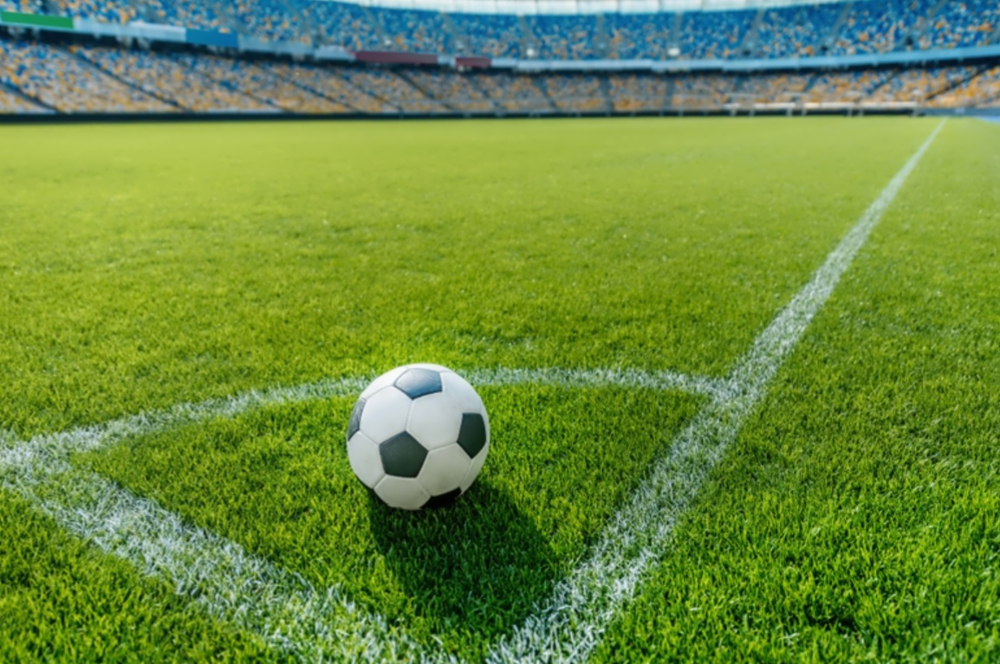

In [ ]:
cv2_imshow(panorama)

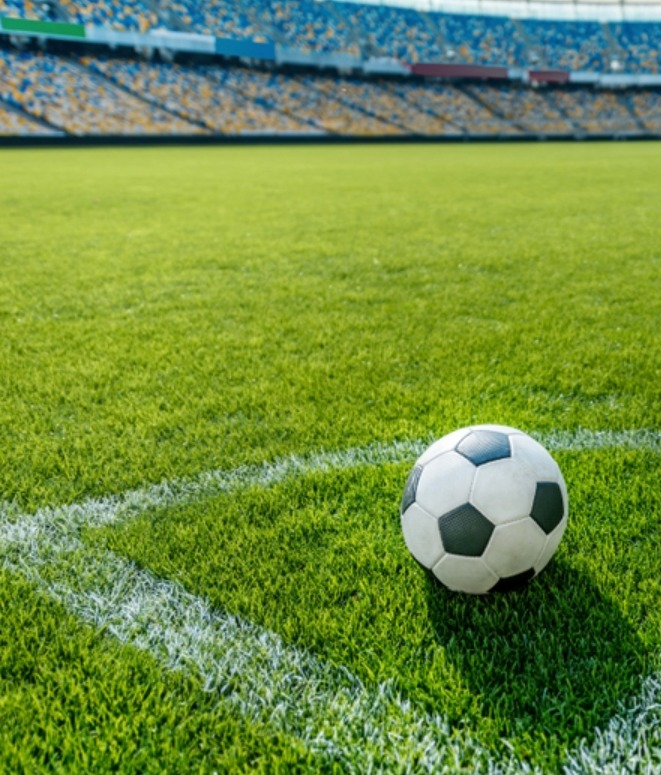

In [ ]:
img = cv2.imread("/content/Football_H1.jpeg")
cv2_imshow(img)

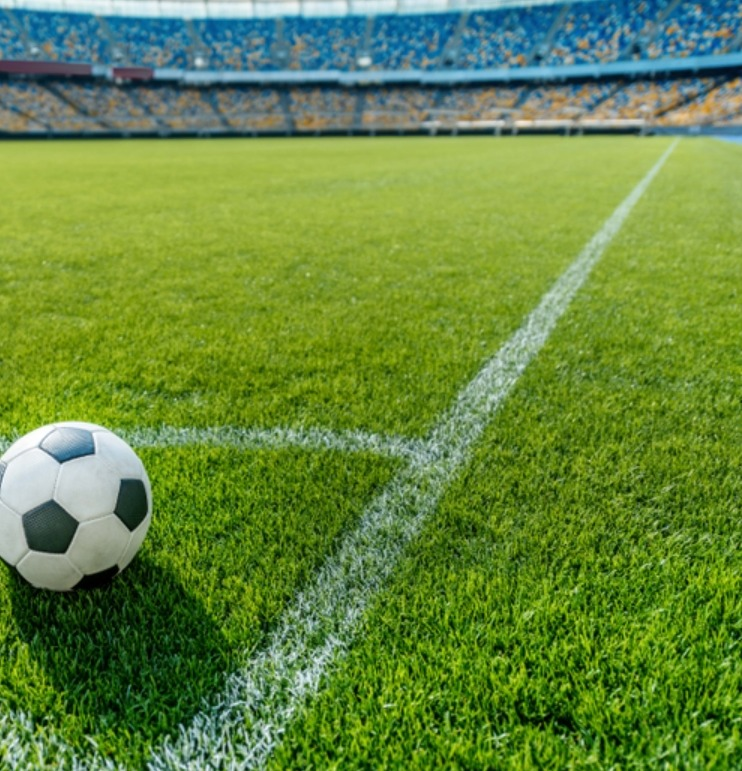

In [ ]:
img = cv2.imread("/content/Football_H2.jpeg")
cv2_imshow(img)

## example 1

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2

In [ ]:
def plot_image(img, figsize_in_inches=(5,5)):
    fig, ax = plt.subplots(figsize=figsize_in_inches)
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.show()

def plot_images(imgs, figsize_in_inches=(5,5)):
    fig, axs = plt.subplots(1, len(imgs), figsize=figsize_in_inches)
    for col, img in enumerate(imgs):
        axs[col].imshow(cv2.COLOR_LUV2BGR.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.show()

In [ ]:
from stitching.images import Images

lists = ['/content/Football_H1.jpeg','/content/Football_H2.jpeg']
images = Images.of(lists)

medium_imgs = list(images.resize(Images.Resolution.MEDIUM))
low_imgs = list(images.resize(Images.Resolution.LOW))
final_imgs = list(images.resize(Images.Resolution.FINAL))

In [ ]:
def plot_images_in_subplots(images_list, title):

    num_images = len(images_list)
    num_cols = min(num_images, 3)  # Limit the maximum number of columns to 3
    num_rows = (num_images + num_cols - 1) // num_cols

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(8, 4))
    fig.suptitle(title)

    # Ensure axes is always a 2-dimensional array
    axes = axes.reshape((num_rows, num_cols))

    for i, img in enumerate(images_list):
        row = i // num_cols
        col = i % num_cols
        ax = axes[row, col]
        ax.imshow(img)
        ax.axis('off')

    plt.tight_layout()
    plt.show()

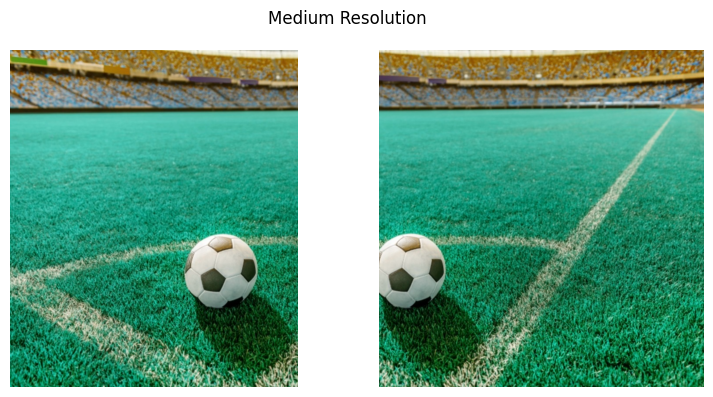

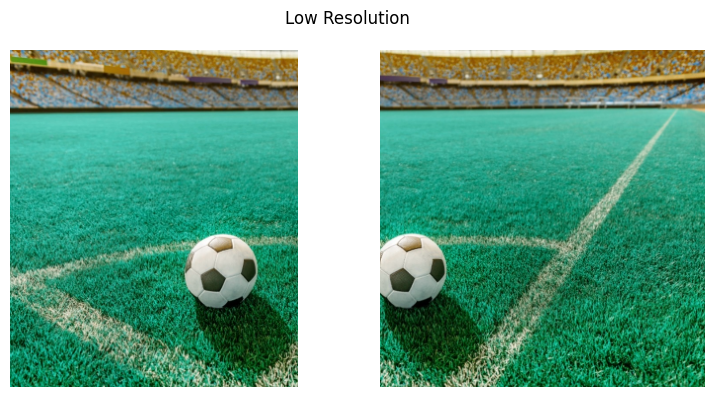

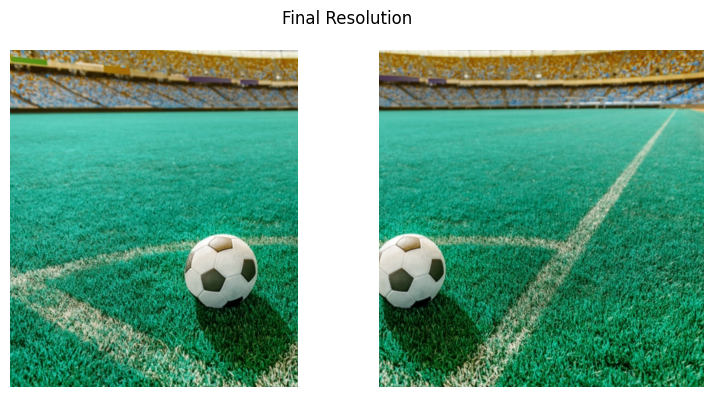

In [ ]:
plot_images_in_subplots(medium_imgs, "Medium Resolution")
plot_images_in_subplots(low_imgs, "Low Resolution")
plot_images_in_subplots(final_imgs, "Final Resolution")

In [ ]:
original_size = images.sizes[0]
medium_size = images.get_image_size(medium_imgs[0])
low_size = images.get_image_size(low_imgs[0])
final_size = images.get_image_size(final_imgs[0])

print(f"Original Size: {original_size}  -> {'{:,}'.format(np.prod(original_size))} px ~ 1 MP")
print(f"Medium Size:   {medium_size}  -> {'{:,}'.format(np.prod(medium_size))} px ~ 0.6 MP")
print(f"Low Size:      {low_size}   -> {'{:,}'.format(np.prod(low_size))} px ~ 0.1 MP")
print(f"Final Size:    {final_size}  -> {'{:,}'.format(np.prod(final_size))} px ~ 1 MP")

Original Size: (661, 775)  -> 512,275 px ~ 1 MP
Medium Size:   (661, 775)  -> 512,275 px ~ 0.6 MP
Low Size:      (292, 342)   -> 99,864 px ~ 0.1 MP
Final Size:    (661, 775)  -> 512,275 px ~ 1 MP


In [ ]:
from stitching.feature_detector import FeatureDetector

finder = FeatureDetector()
features = [finder.detect_features(img) for img in medium_imgs]
keypoints_center_img = finder.draw_keypoints(medium_imgs[1], features[1])

In [ ]:
def plot_image(img, figsize_in_inches=(5,5)):
    fig, ax = plt.subplots(figsize=figsize_in_inches)
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.show()

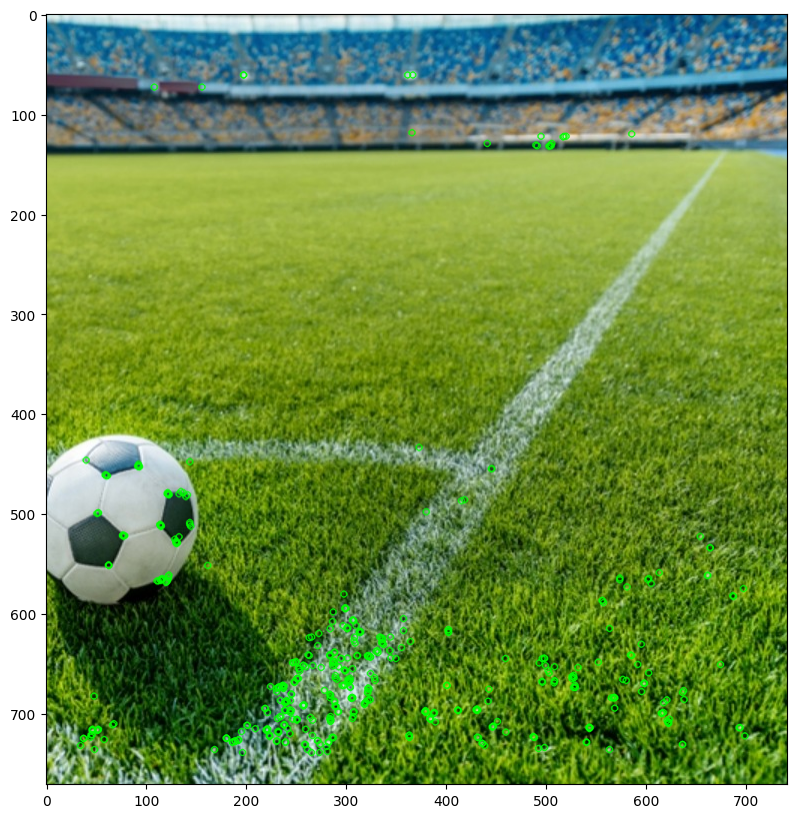

In [ ]:
plot_image(keypoints_center_img,(15,10))

In [ ]:
from stitching.feature_matcher import FeatureMatcher

matcher = FeatureMatcher()
matches = matcher.match_features(features)

In [ ]:
matcher.get_confidence_matrix(matches)

array([[0.        , 2.21079692],
       [2.21079692, 0.        ]])

Matches Image 1 to Image 2


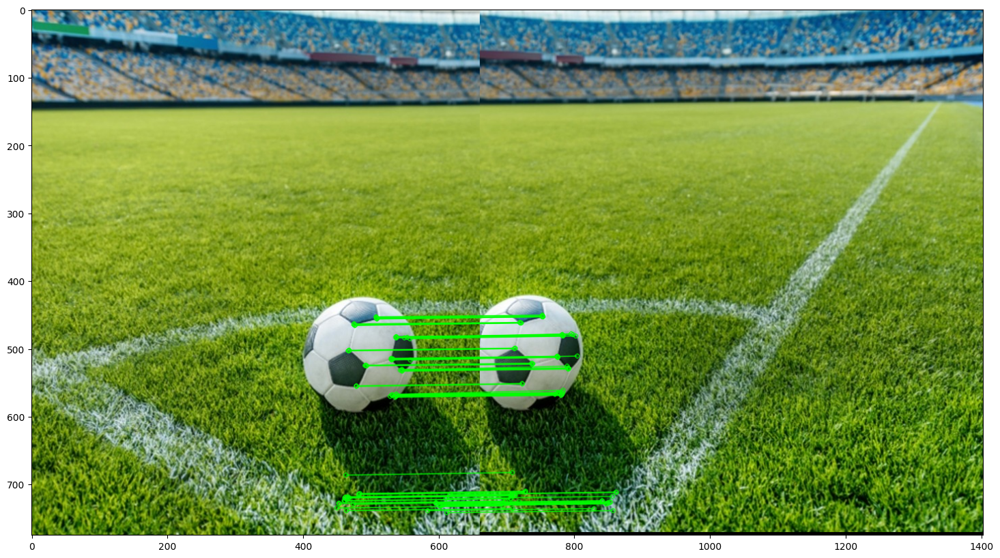

In [ ]:
all_relevant_matches = matcher.draw_matches_matrix(medium_imgs, features, matches, conf_thresh=1,
                                                   inliers=True, matchColor=(0, 255, 0))

for idx1, idx2, img in all_relevant_matches:
    print(f"Matches Image {idx1+1} to Image {idx2+1}")
    plot_image(img, (20,10))

In [ ]:
from stitching.subsetter import Subsetter

subsetter = Subsetter()
dot_notation = subsetter.get_matches_graph(images.names, matches)
print(dot_notation)

graph matches_graph{
"Football_H1.jpeg" -- "Football_H2.jpeg"[label="Nm=103, Ni=86, C=2.2108"];
}


In [ ]:
indices = subsetter.get_indices_to_keep(features, matches)

medium_imgs = subsetter.subset_list(medium_imgs, indices)
low_imgs = subsetter.subset_list(low_imgs, indices)
final_imgs = subsetter.subset_list(final_imgs, indices)
features = subsetter.subset_list(features, indices)
matches = subsetter.subset_matches(matches, indices)

images.subset(indices)

print(images.names)
print(matcher.get_confidence_matrix(matches))

['/content/Football_H1.jpeg', '/content/Football_H2.jpeg']
[[0.         2.21079692]
 [2.21079692 0.        ]]


In [ ]:
from stitching.camera_estimator import CameraEstimator
from stitching.camera_adjuster import CameraAdjuster
from stitching.camera_wave_corrector import WaveCorrector

camera_estimator = CameraEstimator()
camera_adjuster = CameraAdjuster()
wave_corrector = WaveCorrector()

cameras = camera_estimator.estimate(features, matches)
cameras = camera_adjuster.adjust(features, matches, cameras)
cameras = wave_corrector.correct(cameras)

In [ ]:
from stitching.warper import Warper
warper = Warper()
warper.set_scale(cameras)

In [ ]:
low_sizes = images.get_scaled_img_sizes(Images.Resolution.LOW)
camera_aspect = images.get_ratio(Images.Resolution.MEDIUM, Images.Resolution.LOW)  # since cameras were obtained on medium imgs

warped_low_imgs = list(warper.warp_images(low_imgs, cameras, camera_aspect))
warped_low_masks = list(warper.create_and_warp_masks(low_sizes, cameras, camera_aspect))
low_corners, low_sizes = warper.warp_rois(low_sizes, cameras, camera_aspect)

final_sizes = images.get_scaled_img_sizes(Images.Resolution.FINAL)
camera_aspect = images.get_ratio(Images.Resolution.MEDIUM, Images.Resolution.FINAL)

warped_final_imgs = list(warper.warp_images(final_imgs, cameras, camera_aspect))
warped_final_masks = list(warper.create_and_warp_masks(final_sizes, cameras, camera_aspect))
final_corners, final_sizes = warper.warp_rois(final_sizes, cameras, camera_aspect)

In [ ]:
def plot_images(imgs, figsize_in_inches=(5,5)):
    fig, axs = plt.subplots(1, len(imgs), figsize=figsize_in_inches)
    for col, img in enumerate(imgs):
        axs[col].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.show()

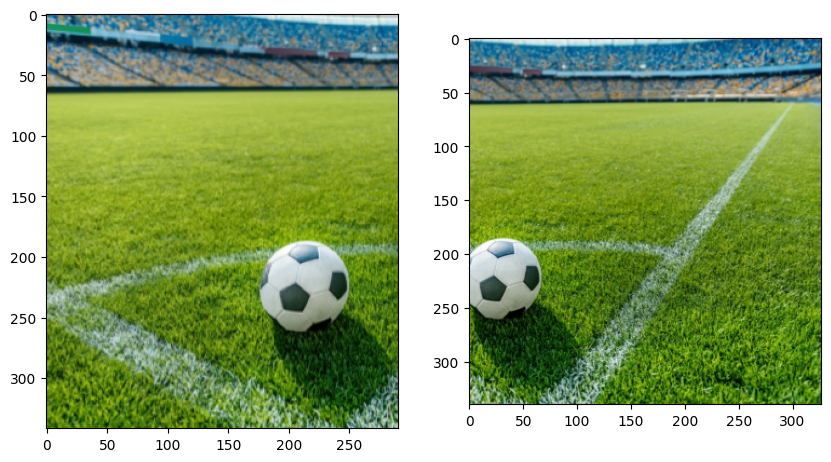

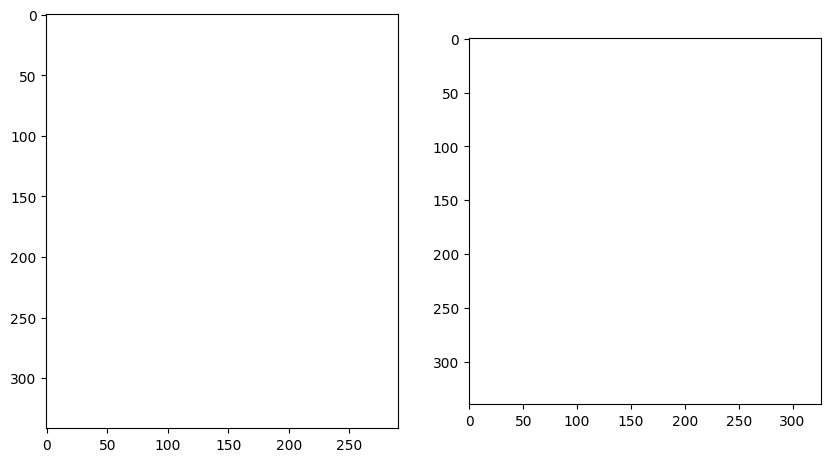

In [ ]:
plot_images(warped_low_imgs, (10,10))
plot_images(warped_low_masks, (10,10))

In [ ]:
print(final_corners)
print(final_sizes)

[(-558, 11959), (-142, 11962)]
[(660, 774), (741, 770)]


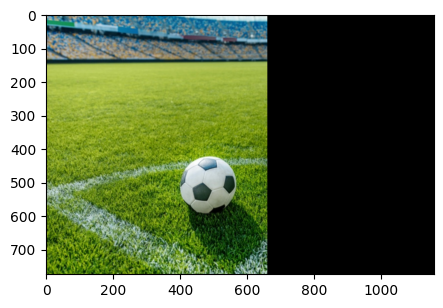

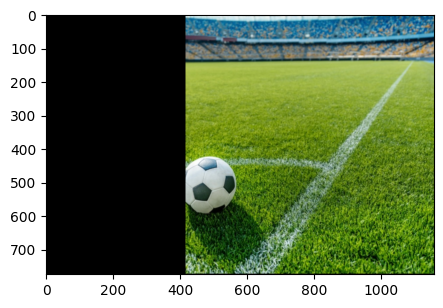

In [ ]:
from stitching.timelapser import Timelapser

timelapser = Timelapser('as_is')
timelapser.initialize(final_corners, final_sizes)

for img, corner in zip(warped_final_imgs, final_corners):
    timelapser.process_frame(img, corner)
    frame = timelapser.get_frame()
    plot_image(frame, (5,5))

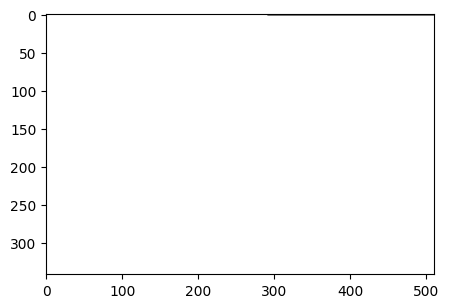

In [ ]:
from stitching.cropper import Cropper
cropper = Cropper()
mask = cropper.estimate_panorama_mask(warped_low_imgs, warped_low_masks, low_corners, low_sizes)
plot_image(mask, (5,5))

In [ ]:
lir = cropper.estimate_largest_interior_rectangle(mask)
lir = cropper.estimate_largest_interior_rectangle(mask)
print(lir)

Rectangle(x=0, y=2, width=510, height=340)


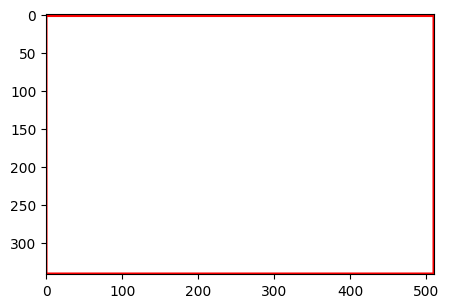

In [ ]:
plot = lir.draw_on(mask, size=2)
plot_image(plot, (5,5))

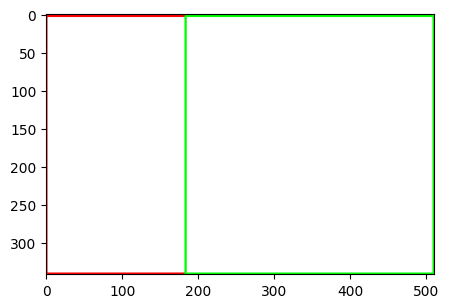

In [ ]:
low_corners = cropper.get_zero_center_corners(low_corners)
rectangles = cropper.get_rectangles(low_corners, low_sizes)

plot = rectangles[1].draw_on(plot, (0, 255, 0), 2)  # The rectangle of the center img
plot_image(plot, (5,5))

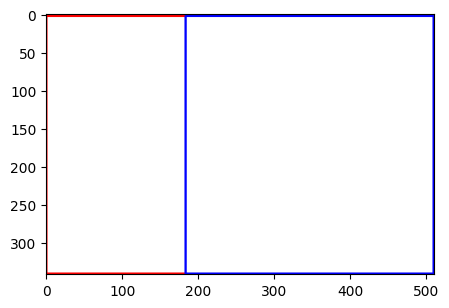

In [ ]:
overlap = cropper.get_overlap(rectangles[1], lir)
plot = overlap.draw_on(plot, (255, 0, 0), 2)
plot_image(plot, (5,5))

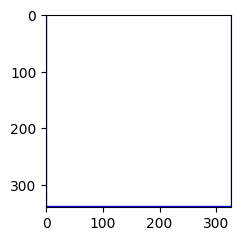

In [ ]:
intersection = cropper.get_intersection(rectangles[1], overlap)
plot = intersection.draw_on(warped_low_masks[1], (255, 0, 0), 2)
plot_image(plot, (2.5,2.5))

In [ ]:
cropper.prepare(warped_low_imgs, warped_low_masks, low_corners, low_sizes)

cropped_low_masks = list(cropper.crop_images(warped_low_masks))
cropped_low_imgs = list(cropper.crop_images(warped_low_imgs))
low_corners, low_sizes = cropper.crop_rois(low_corners, low_sizes)

lir_aspect = images.get_ratio(Images.Resolution.LOW, Images.Resolution.FINAL)  # since lir was obtained on low imgs
cropped_final_masks = list(cropper.crop_images(warped_final_masks, lir_aspect))
cropped_final_imgs = list(cropper.crop_images(warped_final_imgs, lir_aspect))
final_corners, final_sizes = cropper.crop_rois(final_corners, final_sizes, lir_aspect)

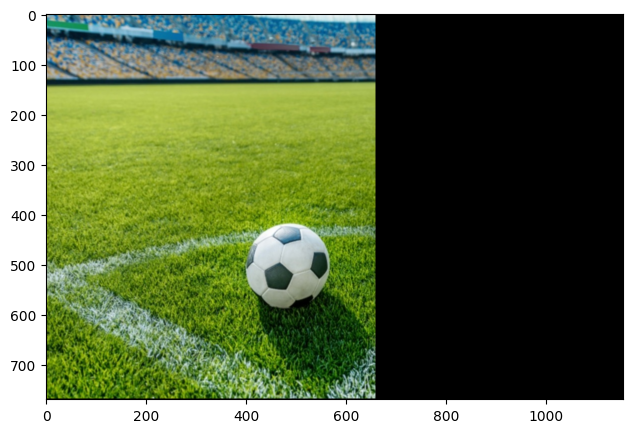

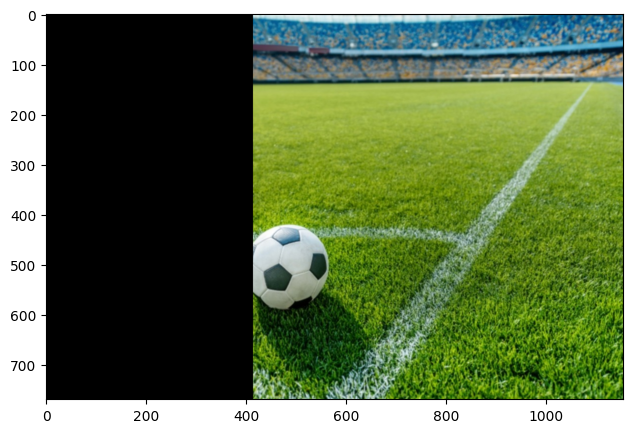

In [ ]:
timelapser = Timelapser('as_is')
timelapser.initialize(final_corners, final_sizes)

for img, corner in zip(cropped_final_imgs, final_corners):
    timelapser.process_frame(img, corner)
    frame = timelapser.get_frame()
    plot_image(frame, (8,5))

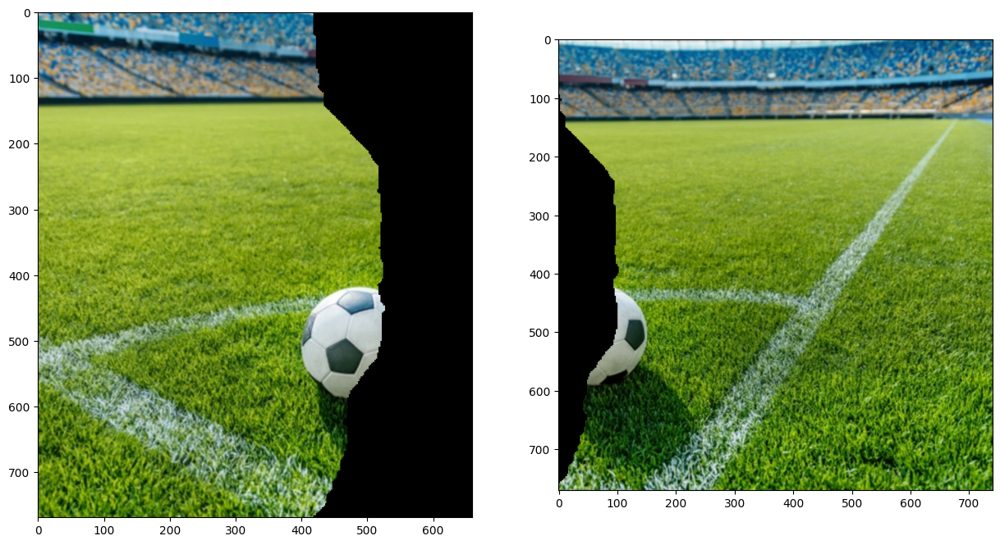

In [ ]:
from stitching.seam_finder import SeamFinder

seam_finder = SeamFinder()

seam_masks = seam_finder.find(cropped_low_imgs, low_corners, cropped_low_masks)
seam_masks = [seam_finder.resize(seam_mask, mask) for seam_mask, mask in zip(seam_masks, cropped_final_masks)]

seam_masks_plots = [SeamFinder.draw_seam_mask(img, seam_mask) for img, seam_mask in zip(cropped_final_imgs, seam_masks)]
plot_images(seam_masks_plots, (15,10))

In [ ]:
from stitching.exposure_error_compensator import ExposureErrorCompensator

compensator = ExposureErrorCompensator()
compensator.feed(low_corners, cropped_low_imgs, cropped_low_masks)
compensated_imgs = [compensator.apply(idx, corner, img, mask)
                    for idx, (img, mask, corner)
                    in enumerate(zip(cropped_final_imgs, cropped_final_masks, final_corners))]

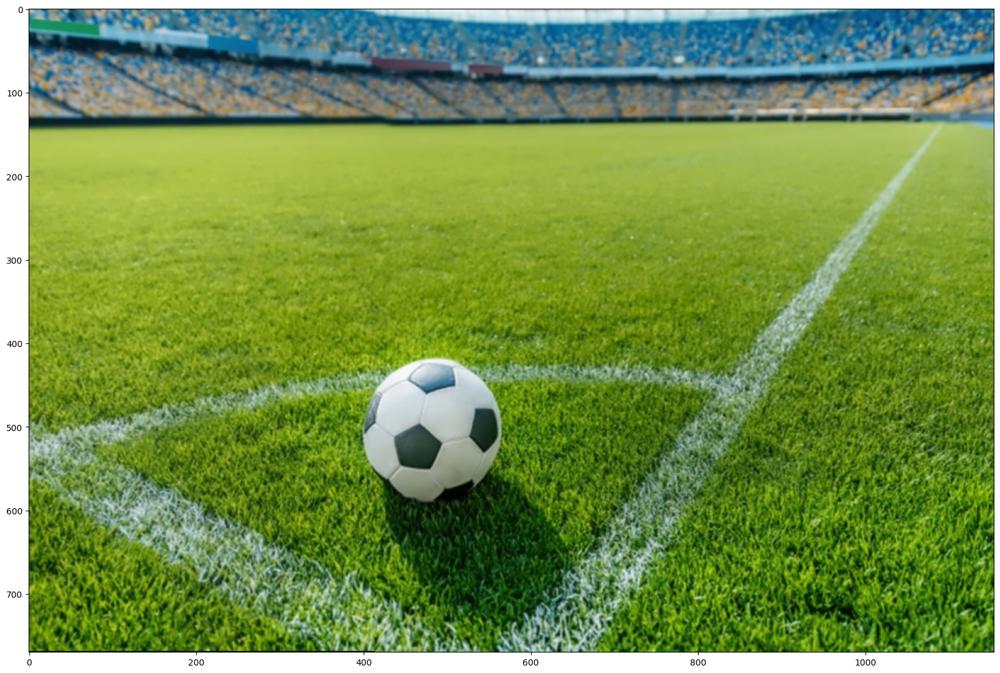

In [ ]:
from stitching.blender import Blender

blender = Blender()
blender.prepare(final_corners, final_sizes)
for img, mask, corner in zip(compensated_imgs, seam_masks, final_corners):
    blender.feed(img, mask, corner)
panorama, _ = blender.blend()
plot_image(panorama, (20,20))

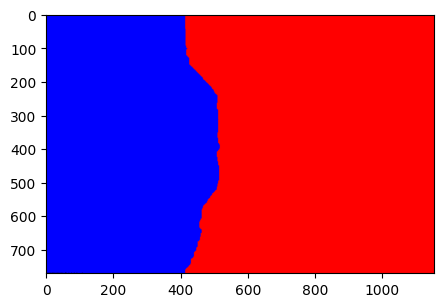

In [ ]:
blended_seam_masks = seam_finder.blend_seam_masks(seam_masks, final_corners, final_sizes)
plot_image(blended_seam_masks, (5,5))

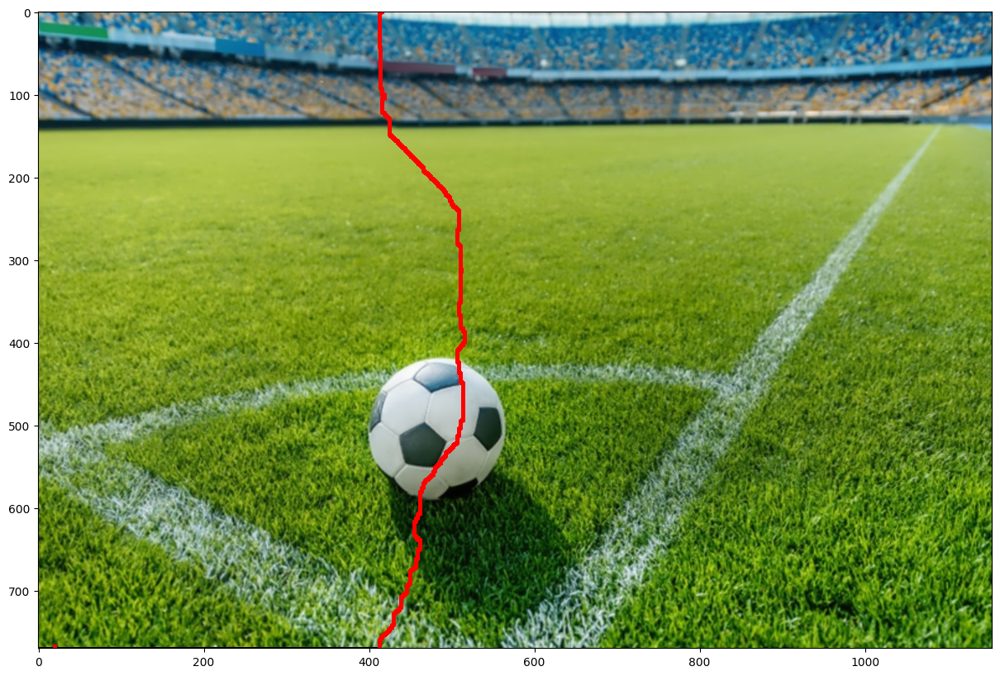

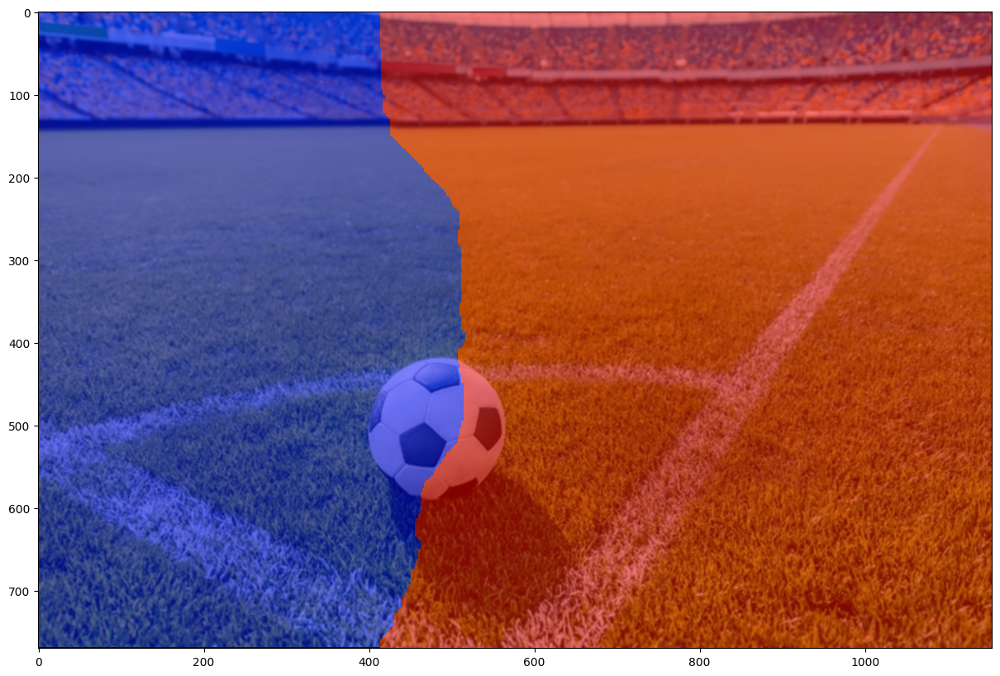

In [ ]:
plot_image(seam_finder.draw_seam_lines(panorama, blended_seam_masks, linesize=3), (15,10))
plot_image(seam_finder.draw_seam_polygons(panorama, blended_seam_masks), (15,10))

In [ ]:
from stitching import Stitcher

stitcher = Stitcher()
panorama = stitcher.stitch(lists)  # the user is warned that only a subset of input images is stitched

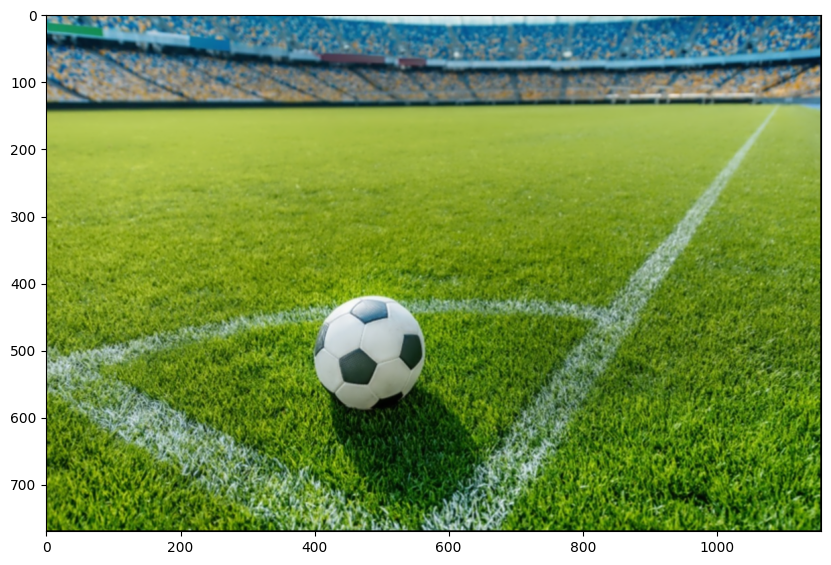

In [ ]:
plot_image(panorama, (10,10))